# Install necessary modules.

In [66]:
#MAKE GIT REPO PUBLIC!!!
!pip install chart-studio
!pip install plotly
!pip install scipy==1.2 --upgrade
!pip install --upgrade gdown
!pip install pca

# Import libraries.

In [67]:
#import libraries
import numpy as np 
import pandas as pd 
from google.colab import files


#EDA 
import seaborn as sns 
import matplotlib.pyplot as plt
from chart_studio import plotly
from plotly import tools
import chart_studio.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
%matplotlib inline


#PCA
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from pca import pca as pca_mod
from sklearn.cluster import KMeans
import plotly.express as px

#Imputation 
from sklearn.impute import SimpleImputer

#split
from sklearn.model_selection import train_test_split

# Define the EDA class with functionalities to load and pre-process data, and display visualizations.

In [111]:
class EDA:
    acc_data= acc_data_reduced= acc_data_reduced_corr= pd.DataFrame()
    num_cols= cat_cols= []
    def __init__(self, acc_data):
        self.acc_data= acc_data

    def clean_data(self):
        #Percentage of missing data
        print("Percentage of missing data:\n")
        print(acc_data.isnull().mean().sort_values(ascending=False))
        #Delete data with > 30% missing data
        print("Deleting some unncessary columns as well as data with > 30% missing...\n")
        keep = self.acc_data.columns[self.acc_data.isnull().mean() < 0.3].to_list()
        acc_data_reduced= self.acc_data[keep]
        keep_2 = ['addr_state', 'annual_inc', 'application_type', 'dti', 'earliest_cr_line', 'emp_length', 'emp_title', 'fico_range_high', 'fico_range_low', 'grade', 'home_ownership', 'initial_list_status', 'installment', 'int_rate', 'issue_d', 'loan_amnt', 'loan_status', 'mort_acc', 'open_acc', 'pub_rec', 'pub_rec_bankruptcies', 'purpose', 'revol_bal', 'revol_util', 'sub_grade', 'term', 'title', 'total_acc', 'verification_status', 'zip_code']
        acc_data_reduced= acc_data_reduced[keep_2] 
        plt.figure(figsize=(18,4),dpi=400)
        sns.barplot(y=(acc_data_reduced.isnull().mean()*100).sort_values(), x=(acc_data_reduced.isnull().mean()*100).sort_values().index, palette='Blues')
        plt.xticks(rotation=90);  
        plt.xlabel('features')
        plt.ylabel('% missing data')
        self.acc_data_reduced= acc_data_reduced   
        # return acc_data_reduced
        
    def loan_status_EDA(self):
        print(self.acc_data_reduced['loan_status'].value_counts())
        fig, ax= plt.subplots(figsize= (13,8))
        ax.tick_params(axis= 'x', rotation= 90)
        sns.countplot(x= self.acc_data_reduced['loan_status'], palette= 'Dark2')   

    def clean_data_correlation(self):
        #Everything except Fully Paid, In Grace Period and Current loans are not good loans. We can investigate the contributing factors to both good and bad loans.
        self.acc_data_reduced['good_loan']= (~self.acc_data_reduced['loan_status'].isin(['Current', 'Fully Paid', 'In Grace Period'])).astype('int')
        print(self.acc_data_reduced['good_loan'].value_counts())
        self.acc_data_reduced_corr= pd.DataFrame(self.acc_data_reduced.copy())
        #Drop missing values for correlations
        self.acc_data_reduced_corr.dropna(inplace= True)
        #Create a single credit score column fico and drop the high and low ranges
        self.acc_data_reduced_corr['fico'] = (self.acc_data_reduced_corr['fico_range_high'] + self.acc_data_reduced_corr['fico_range_low']) / 2
        self.acc_data_reduced_corr = self.acc_data_reduced_corr.drop(['fico_range_high', 'fico_range_low'], axis=1)
        self.num_cols = list(self.acc_data_reduced_corr._get_numeric_data().columns)
        self.cat_cols = [i for i in list(self.acc_data_reduced.columns) if i not in self.num_cols]

    def create_correlation(self):
        return self.acc_data_reduced_corr.corr()
    
    def correlation_1(self, corr):
        
        plt.figure(figsize=(15,15))
        sns.heatmap(corr, center=0, linewidths=.1, annot=True, linecolor ='black', cmap = 'RdBu', square=True)
    
    def correlation_2(self, corr):
        mask = np.triu(np.ones_like(corr, dtype=np.bool))
        #Set up the matplotlib figure
        f, ax = plt.subplots(figsize=(7, 7))
        #Generate a custom diverging colormap
        cmap = sns.diverging_palette(220, 10, as_cmap=True)
        #Draw the heatmap with the mask and correct aspect ratio
        sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

    
    def top_correlations_scatterplot(self, corr):
        def get_redundant_pairs(df):
            '''Get diagonal and lower triangular pairs of correlation matrix'''
            pairs_to_drop = set()
            cols = corr.columns
            for i in range(0, corr.shape[1]):
                for j in range(0, i+1):
                    pairs_to_drop.add((cols[i], cols[j]))
            return pairs_to_drop

        def get_top_abs_correlations(df, n=5):
            au_corr = df.corr().abs().unstack()
            labels_to_drop = get_redundant_pairs(df)
            au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
            return au_corr[0:n]
        
        topCors = get_top_abs_correlations(self.acc_data_reduced_corr,20)
        print('Top correlation pairs:\n')
        for item in topCors.iteritems():
            print(item)  
        for item in topCors.iteritems():
            xname = item[0][0]
            yname = item[0][1]
            colors = ('blue')
            sns.scatterplot(data= self.acc_data_reduced_corr, x= xname, y= yname, alpha=0.5, palette= 'Dark2')
            plt.title('Scatter plot')
            plt.xlabel(xname)
            plt.ylabel(yname)
            plt.show()
    
    def top_features_numeric(self):
        num_corr= self.acc_data_reduced_corr.corr()['good_loan'].drop('good_loan').sort_values().plot(kind= 'bar')

    def categorical_correlations(self, dim1= 'good_loan', dim2= 'purpose'):
        c = pd.crosstab(self.acc_data_reduced_corr[dim1], columns = self.acc_data_reduced_corr[dim2])
        print(c/c.sum())
        fig, ax= plt.subplots(figsize= (13,8))
        ax.tick_params(axis= 'x', rotation= 90)
        sns.countplot(data= self.acc_data_reduced_corr, x= dim2, hue= dim1, palette= 'Dark2', order = self.acc_data_reduced_corr[dim2].value_counts().index)

    def parallel_coordinates_preprocess(self):
        #Our data is extremely large. To visualize parallel coordinates, I'm going to take a random sample of 10% of the data.
        df_clust= self.acc_data_reduced_corr.sample(frac=0.1)
        n_cols= []
        for col in self.acc_data_reduced_corr.columns:
            if col in self.num_cols:
                n_cols.append(col)
        self.num_cols= n_cols
        df_clust= df_clust[n_cols]
        clusters = KMeans(n_clusters = 5, random_state = 0).fit(df_clust)
        df_clust['cluster'] = clusters.labels_
        return df_clust
    
    def parallel_coordinates_viz(self, df_clust, color_col= 'cluster'):

        fig = px.parallel_coordinates(df_clust, 
                                    color=color_col, 
                                    color_continuous_scale=px.colors.diverging.Tealrose[::-1])
                                    #   color_continuous_midpoint=2)
        fig.show(renderer= 'colab')
    

    def pca_viz(self, df_pca, n=14):
        #Our data is extremely large. To visualize PCA, I'm going to take a random sample of 10% of the data: df_pca
        dat = StandardScaler().fit_transform(df_pca)
        pca = PCA(n_components=n)
        # defaults number of PCs to number of columns in imported data (ie number of
        # features), but can be set to any integer less than or equal to that value
        pca.fit(dat)
        xvector = pca.components_[0] 
        yvector = pca.components_[1]
        pca_components = pd.DataFrame({'Variables':df_pca.columns.values,'Loadings X': xvector, 'Loadings Y': yvector})
        print(pca_components)
        model = pca_mod(n_components=n)
        pca_df = pd.DataFrame(dat, columns=df_pca.columns)
        # Fit transform
        results = model.fit_transform(pca_df)
        # Make biplot with the number of features
        fig, ax = plt.subplots(1, 2)
        ax[0]= model.biplot(n_feat=n, y = pca_df['good_loan'], label=False, legend=True)
        ax[1]= model.plot()

    def interest_rate_viz_displot(self):
        # fig, ax = plt.subplots(1, 2)
        plt.figure(figsize=(12,5), dpi=110)
        sns.displot(data= self.acc_data_reduced_corr, x= 'int_rate', bins=100, hue= 'good_loan', kde= True, palette= 'Dark2')

    def interest_rate_viz_violin(self):
        plt.figure(figsize=(12,5), dpi=110)
        sns.violinplot(data= self.acc_data_reduced_corr, x= 'good_loan', y= 'int_rate', palette= 'Dark2')

    def credit_score_viz_displot(self):
        plt.figure(figsize=(12,5), dpi=110)
        sns.displot(data= self.acc_data_reduced_corr, x= 'fico', bins=100, hue= 'good_loan', kde= True, palette= 'Dark2')

    def credit_score_viz_violin(self):
        plt.figure(figsize=(12,5), dpi=110)
        sns.violinplot(data= self.acc_data_reduced_corr, x= 'good_loan', y= 'fico', palette= 'Dark2')
    

            

# Download dataset into working directory.

In [4]:
!gdown --id 1qswuejCLW8dcvNNLGhrBVM23ypZQryFi

Downloading...
From: https://drive.google.com/uc?id=1qswuejCLW8dcvNNLGhrBVM23ypZQryFi
To: /content/accepted_2007_to_2018Q4.csv
100% 1.68G/1.68G [00:12<00:00, 131MB/s]


In [5]:
acc_data = pd.read_csv('accepted_2007_to_2018Q4.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning:

Columns (0,19,49,59,118,129,130,131,134,135,136,139,145,146,147) have mixed types.Specify dtype option on import or set low_memory=False.



## Data Inspection

In [62]:
acc_data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,...,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_earliest_cr_line,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,hardship_flag,hardship_type,hardship_reason,hardship_status,deferral_term,hardship_amount,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,68407277,NaN,3600.0,3600.0,3600.0,36 months,13.99,123.03,C,C4,leadman,10+ years,MORTGAGE,55000.0,Not Verified,Dec-2015,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,debt_consolidation,Debt consolidation,190xx,PA,5.91,0.0,Aug-2003,675.0,679.0,1.0,30.0,NaN,7.0,0.0,2765.0,29.7,13.0,w,0.00,0.00,...,178050.0,7746.0,2400.0,13734.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,68355089,NaN,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,Engineer,10+ years,MORTGAGE,65000.0,Not Verified,Dec-2015,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,Business,577xx,SD,16.06,1.0,Dec-1999,715.0,719.0,4.0,6.0,NaN,22.0,0.0,21470.0,19.2,38.0,w,0.00,0.00,...,314017.0,39475.0,79300.0,24667.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,68341763,NaN,20000.0,20000.0,20000.0,60 months,10.78,432.66,B,B4,truck driver,10+ years,MORTGAGE,63000.0,Not Verified,Dec-2015,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,home_improvement,NaN,605xx,IL,10.78,0.0,Aug-2000,695.0,699.0,0.0,NaN,NaN,6.0,0.0,7869.0,56.2,18.0,w,0.00,0.00,...,218418.0,18696.0,6200.0,14877.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,66310712,NaN,35000.0,35000.0,35000.0,60 months,14.85,829.90,C,C5,Information Systems Officer,10+ years,MORTGAGE,110000.0,Source Verified,Dec-2015,Current,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,debt_consolidation,Debt consolidation,076xx,NJ,17.06,0.0,Sep-2008,785.0,789.0,0.0,NaN,NaN,13.0,0.0,7802.0,11.6,17.0,w,15897.65,15897.65,...,381215.0,52226.0,62500.0,18000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,68476807,NaN,10400.0,10400.0,10400.0,60 months,22.45,289.91,F,F1,Contract Specialist,3 years,MORTGAGE,104433.0,Source Verified,Dec-2015,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,major_purchase,Major purchase,174xx,PA,25.37,1.0,Jun-1998,695.0,699.0,3.0,12.0,NaN,12.0,0.0,21929.0,64.5,35.0,w,0.00,0.00,...,439570.0,95768.0,20300.0,88097.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
acc_data.describe()

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,...,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
count,0.0,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260664e+06,2.258957e+06,2.260639e+06,2.260668e+06,2.260668e+06,2.260638e+06,1.102166e+06,359156.000000,2.260639e+06,2.260639e+06,2.260668e+06,2.258866e+06,2.260639e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260668e+06,2.260523e+06,580775.000000,2260668.0,1.207100e+05,120706.000000,2.260639e+06,2.190392e+06,2.190392e+06,1.394538e+06,...,2.190392e+06,2.190392e+06,2.190392e+06,2.190391e+06,2.190392e+06,2.202078e+06,2.107011e+06,2.190392e+06,2.190392e+06,2.190392e+06,2.190237e+06,2.185289e+06,2.259303e+06,2.260563e+06,2.190392e+06,2.210638e+06,2.210638e+06,2.190392e+06,1.080200e+05,108021.000000,108021.000000,108021.000000,108021.000000,108021.000000,106184.000000,108021.000000,108021.000000,108021.000000,108021.000000,35942.000000,10917.0,10917.000000,10917.0,10917.000000,8651.000000,10917.000000,10917.000000,34246.000000,34246.000000,34246.000000
mean,NaN,1.504693e+04,1.504166e+04,1.502344e+04,1.309283e+01,4.458068e+02,7.799243e+04,1.882420e+01,3.068792e-01,6.985882e+02,7.025884e+02,5.768354e-01,3.454092e+01,72.312842,1.161240e+01,1.975278e-01,1.665846e+04,5.033770e+01,2.416255e+01,4.206891e+03,4.205965e+03,1.208256e+04,1.206439e+04,9.505772e+03,2.431388e+03,1.518453e+00,1.438791e+02,2.398257e+01,3.429346e+03,6.876610e+02,6.755397e+02,1.814580e-02,44.164220,1.0,1.236246e+05,19.251817,4.147942e-03,2.327317e+02,1.424922e+05,9.344199e-01,...,7.726402e+00,8.413439e+00,8.246523e+00,1.400463e+01,5.577951e+00,1.162813e+01,6.373958e-04,2.813652e-03,8.293767e-02,2.076755e+00,9.411458e+01,4.243513e+01,1.281935e-01,4.677109e-02,1.782428e+05,5.102294e+04,2.319377e+04,4.373201e+04,3.361728e+04,669.755603,673.755631,0.633256,1.538997,11.469455,58.169101,3.010554,12.533072,0.046352,0.077568,36.937928,3.0,155.045981,3.0,13.743886,454.798089,11636.883942,193.994321,5010.664267,47.780365,13.191322
std,NaN,9.190245e+03,9.188413e+03,9.192332e+03,4.832138e+00,2.671735e+02,1.126962e+05,1.418333e+01,8.672303e-01,3.301038e+01,3.301124e+01,8.859632e-01,2.190047e+01,26.464094,5.640861e+00,5.705150e-01,2.294831e+04,2.471307e+01,1.198753e+01,7.343239e+03,7.342333e+03,9.901383e+03,9.896992e+03,8.321852e+03,2.679738e+03,1.184159e+01,7.481640e+02,1.312256e+02,6.018248e+03,7.297044e+01,1.110976e+02,1.508131e-01,21.533121,0.0,7.416135e+04,7.822086,6.961656e-02,8.518462e+03,1.606926e+05,1.140700e+00,...,4.701430e+00,7.359114e+00,4.683928e+00,8.038868e+00,3.293434e+00,5.644027e+00,2.710643e-02,5.616522e-02,4.935732e-01,1.830711e+00,9.036140e+0

## Create EDA object and load data.

In [112]:
myEDA= EDA(acc_data)

# Preliminary data cleaning.

Percentage of missing data:

member_id                                     1.000000
orig_projected_additional_accrued_interest    0.996173
hardship_end_date                             0.995171
hardship_start_date                           0.995171
hardship_type                                 0.995171
                                                ...   
policy_code                                   0.000015
revol_bal                                     0.000015
fico_range_high                               0.000015
fico_range_low                                0.000015
id                                            0.000000
Length: 151, dtype: float64
Deleting some unncessary columns as well as data with > 30% missing...



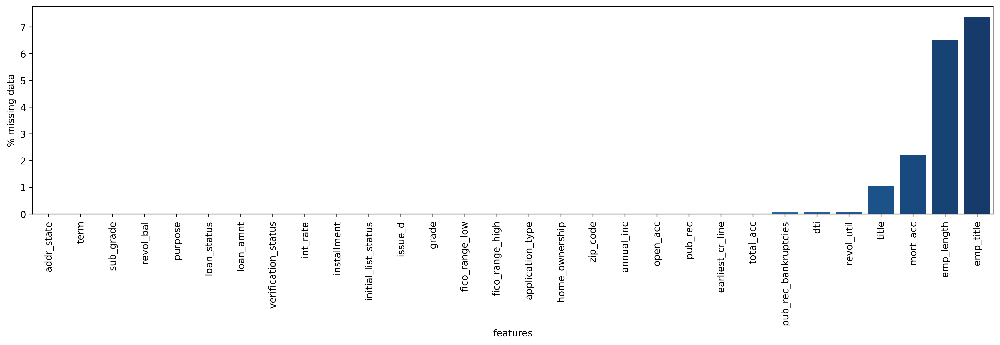

In [113]:
myEDA.clean_data()

The figure above displays our cleaned dataset: % missing data vs features.

## What does our response variable look like?

Fully Paid                                             1076751
Current                                                 878317
Charged Off                                             268559
Late (31-120 days)                                       21467
In Grace Period                                           8436
Late (16-30 days)                                         4349
Does not meet the credit policy. Status:Fully Paid        1988
Does not meet the credit policy. Status:Charged Off        761
Default                                                     40
Name: loan_status, dtype: int64


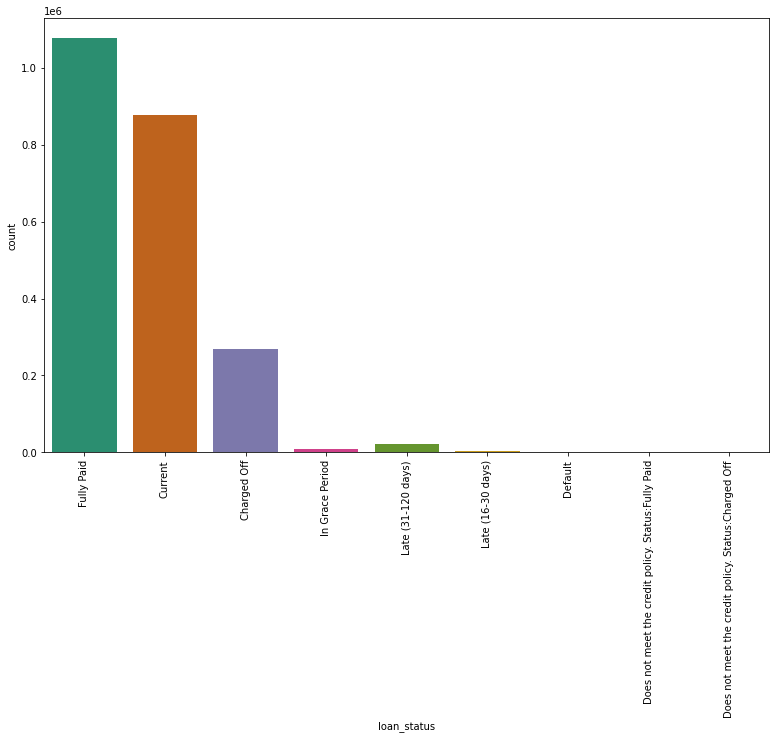

In [47]:
myEDA.loan_status_EDA()

## Correlation Analysis

Another round of data cleaning: remove missing data, binarize 'loan_status' and create a single 'fico' column.
'good_loan' now takes two values: **0 indicates a good loan** (which I'm assuming to be Fully Paid, In Grace Period and Current loans) 1 indicates a bad loan (every other kind of lean) 

In [114]:
myEDA.clean_data_correlation()

0    1963504
1     297197
Name: good_loan, dtype: int64


In [72]:
corr= myEDA.create_correlation()

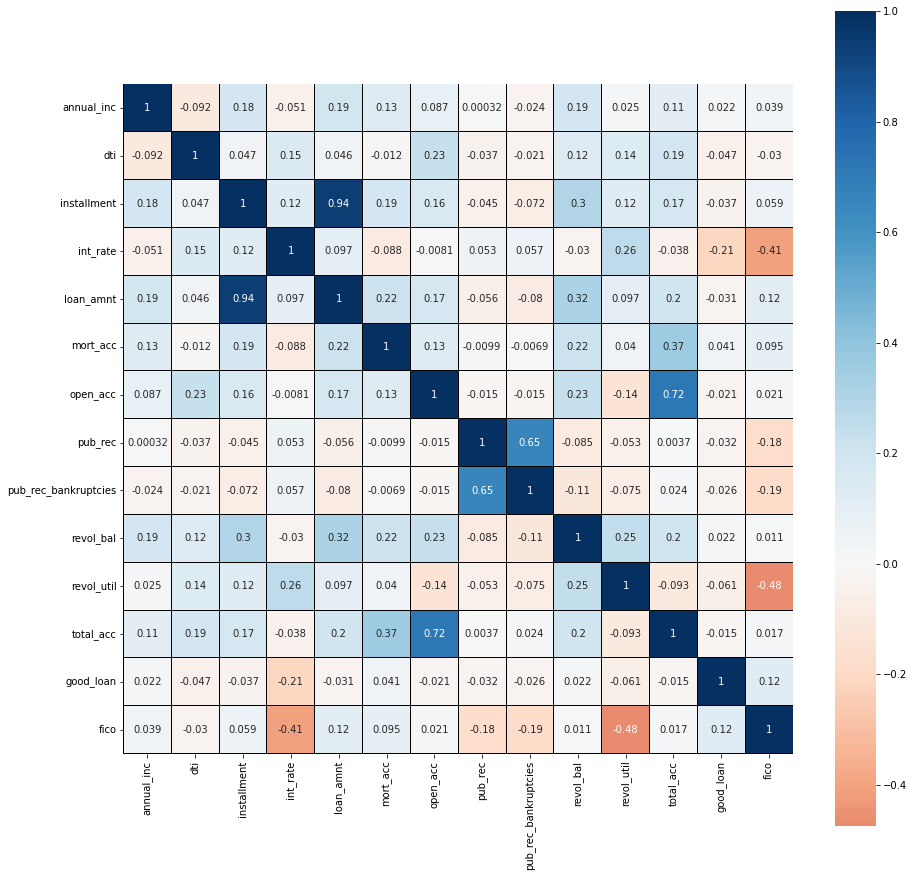

In [73]:
myEDA.correlation_1(corr)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:51: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



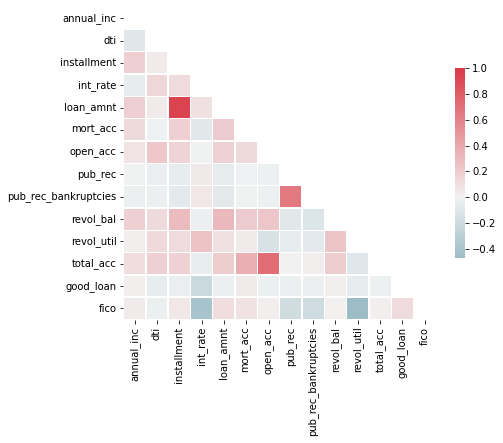

In [74]:
myEDA.correlation_2(corr)

Conclusions:
1. Loan amount and interest rate are highly correlated.
2. A good loan seems to be correlated with interest rate.
3. Loan amount and installment are highly correlated.

## Investigation into categorical feature relations.

purpose         car  credit_card  ...  vacation   wedding
good_loan                         ...                    
0          0.904797     0.896973  ...  0.879512  0.863002
1          0.095203     0.103027  ...  0.120488  0.136998

[2 rows x 14 columns]


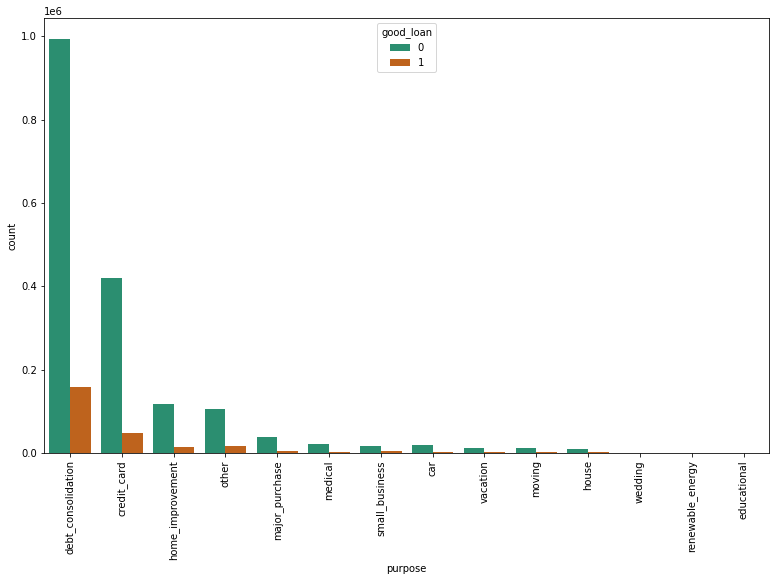

In [98]:
myEDA.categorical_correlations('good_loan', 'purpose')

grade             A         B         C         D         E        F         G
good_loan                                                                     
0          0.965528  0.915334  0.857198  0.796639  0.714834  0.63391  0.595421
1          0.034472  0.084666  0.142802  0.203361  0.285166  0.36609  0.404579


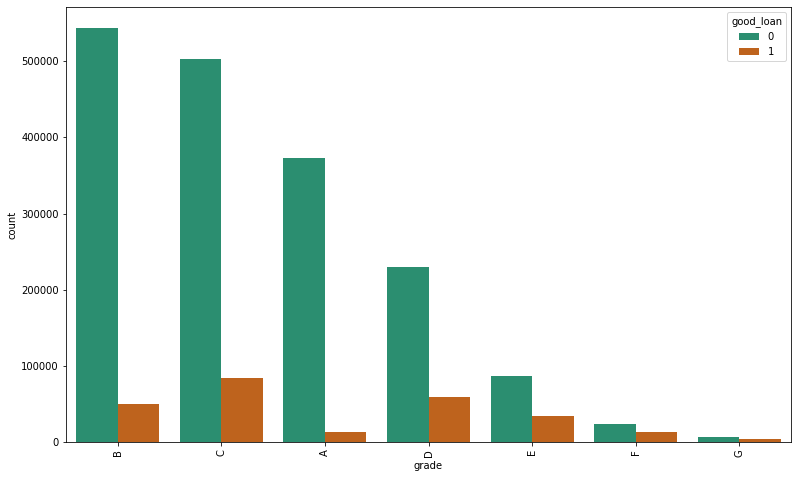

In [99]:
myEDA.categorical_correlations('good_loan', 'grade')

home_ownership       ANY  MORTGAGE      NONE     OTHER      OWN      RENT
good_loan                                                                
0               0.921303  0.888991  0.860465  0.804878  0.87232  0.851395
1               0.078697  0.111009  0.139535  0.195122  0.12768  0.148605


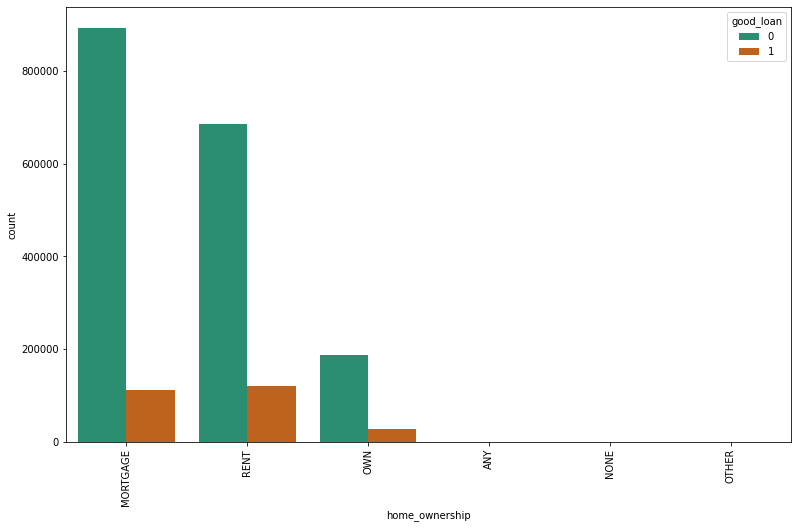

In [100]:
myEDA.categorical_correlations('good_loan', 'home_ownership')

verification_status  Not Verified  Source Verified  Verified
good_loan                                                   
0                        0.911791         0.865836  0.832657
1                        0.088209         0.134164  0.167343


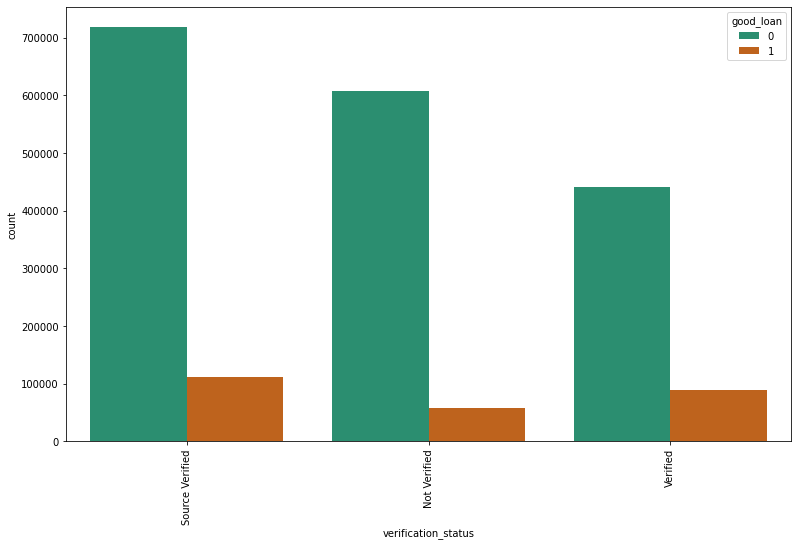

In [101]:
myEDA.categorical_correlations('good_loan', 'verification_status')

emp_length   1 year  10+ years   2 years  ...  8 years   9 years  < 1 year
good_loan                                 ...                             
0           0.86717   0.879954  0.870514  ...  0.85902  0.863133  0.863449
1           0.13283   0.120046  0.129486  ...  0.14098  0.136867  0.136551

[2 rows x 11 columns]


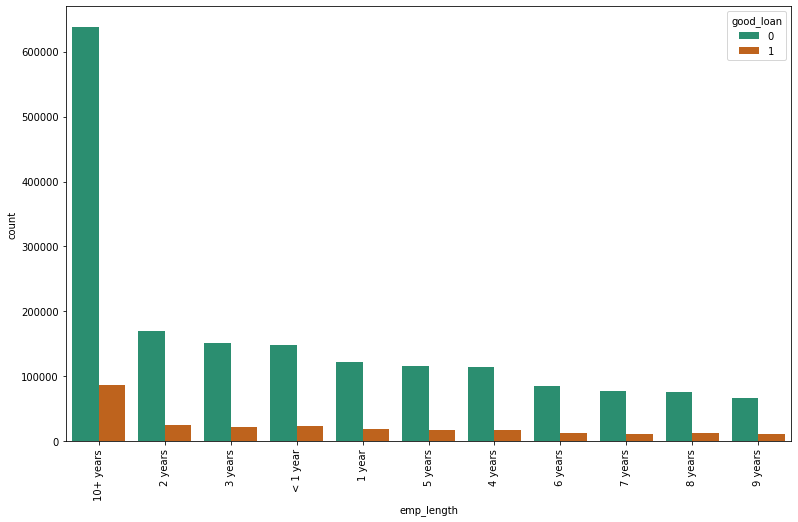

In [102]:
myEDA.categorical_correlations('good_loan', 'emp_length')

Conclusions:
1. Debt consolidation seems to be the primary reason to take loans, and has the highest number of good and bad loans.
2. It looks like F and G subgrade loans aren't paid back that often.
3. Rented and mortgaged home owners seem to have more bad loans.


# Parallel Coordinates

To demonstrate the general trend in the data with parallel coordinates, I have taken a random sample of 10% of the data, which is stored in df_clust.

In [115]:
df_clust= myEDA.parallel_coordinates_preprocess()
myEDA.parallel_coordinates_viz(df_clust, 'good_loan')

We can understand some trends of good and bad loans from these visuals. Good loans seem to have lower installments, interest rates, loan amounts, total credit revolving balance and total number of credit lines currently in the borrower's credit file compared to bad loans. It's curious to see the credit score trends though- outliers fall rather evenly. 

In [116]:
#Colored by cluster
myEDA.parallel_coordinates_viz(df_clust, 'cluster')

A four-cluster plot is able to show some patterns of good and bad loans based on common characteristics. Bad loans have been clusteres together in cluster 0, while good loans have been grouped into clusters 1, 3 and 4. However, cluster 3 seems to be weaker than the others.

# PCA

Perform PCA on a random sample of 10% of the data. By default, consider the number of features in the dataset.

               Variables  Loadings X  Loadings Y
0             annual_inc    0.279033   -0.002522
1                    dti    0.074435    0.070429
2            installment    0.440946   -0.175374
3               int_rate    0.014252   -0.116006
4              loan_amnt    0.452647   -0.166098
5               mort_acc    0.274002    0.139435
6               open_acc    0.291441    0.385800
7                pub_rec   -0.070387    0.481628
8   pub_rec_bankruptcies   -0.088614    0.500216
9              revol_bal    0.330483   -0.084041
10            revol_util    0.088169   -0.306917
11             total_acc    0.324277    0.413942
12             good_loan   -0.002855    0.010908
13               cluster   -0.349423    0.006165
[pca] >Processing dataframe..
[pca] >The PCA reduction is performed on the [14] columns of the input dataframe.
[pca] >Fitting using PCA..
[pca] >Computing loadings and PCs..
[pca] >Computing explained variance..
[pca] >Outlier detection using Hotelling T2 test wit

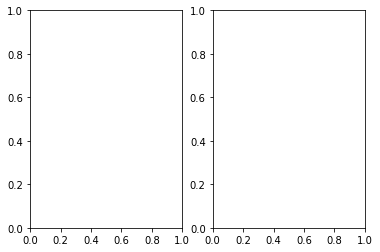

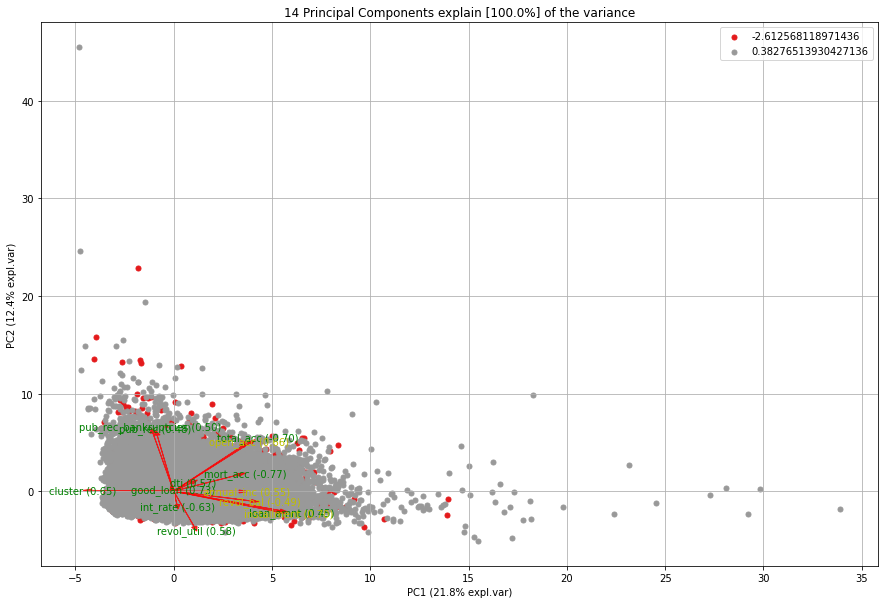

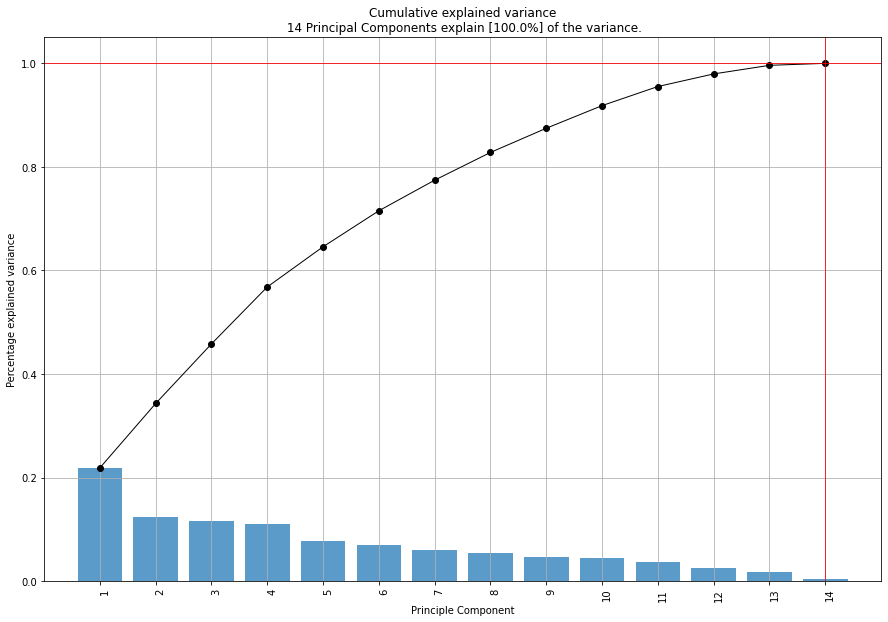

<Figure size 432x288 with 0 Axes>

In [76]:
myEDA.pca_viz(df_clust)
# For example, PCA with 2 components would be:
# myEDA.pca_viz(df_clust, 2)

The most 2 most important principle components collectively explain 34.2% of data variance, which is not that high. This indicates that our data is fairly well reduced, and doesn't need to be drastically reduced further- data variance is explained quite well by most features.

# Some questions I wanted to answer...

### From our correlation analyses, we see that interest rate, credit score and good loans are quite highly correlated. Let's investigate these features further!

### How does credit score affect loans?

<Figure size 1320x550 with 0 Axes>

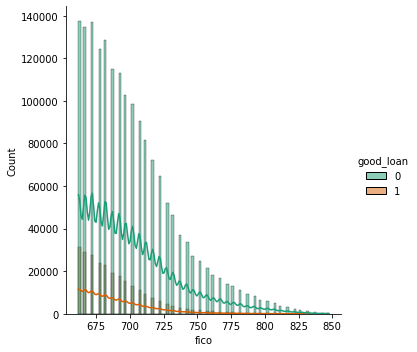

In [117]:
myEDA.credit_score_viz_displot()

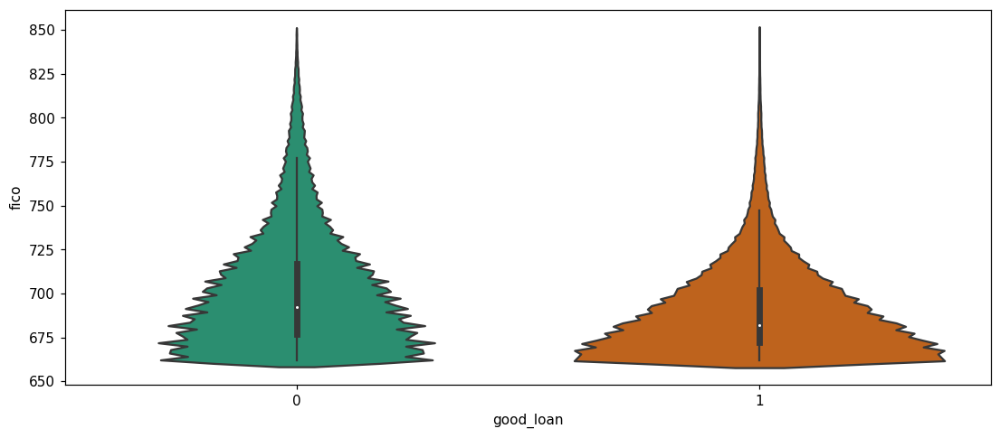

In [118]:
myEDA.credit_score_viz_violin()

Good loans clearly had a significantly higher credit score. However, there seem to be similar outliers/extreme values.

### How does interest rate affect loans?

<Figure size 1320x550 with 0 Axes>

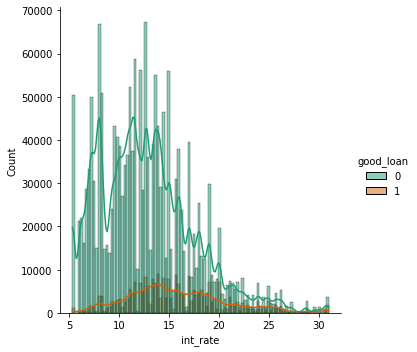

In [119]:
myEDA.interest_rate_viz_displot()

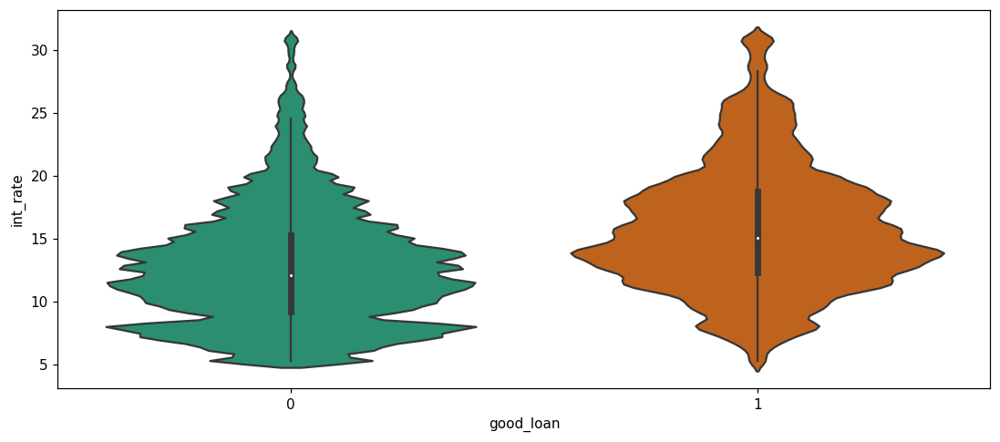

In [120]:
myEDA.interest_rate_viz_violin()

Good loans have significantly lower interest rates than bad ones- the distribution is skewed closer to 0 for good loans.